<a href="https://colab.research.google.com/github/mahmud-nobe/Minerva-Capstone/blob/main/V2_Capstone_Understanding_GMM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Introduction

GMM is a parametric ML model and one of the primary assuptions of GMM is that the dataset is consists of a mixture of two or more normal distribution. In our case, from the context, we can say that we would have two different group of stars: member stars and field stars (i.e. non member stars). The features i.e. the input variables (pmra, pmdec, parallax) for all member stars should stay very close to each other, thus we can say that members are normally distributed in the feature space. But the field stars should be random and uniform and should not follow any normal distribution. 

So our dataset does not satisfy the GMM assumption that all groups are normally distributed. Gao (2018) and Agarwal et. al (2020) mentioned this problem and showed that GMM will not work specially when we have a large sample area compare to the original cluster size. On that case, we would have a large number of field stars and GMM will try to find two separate normally distributed group of stars and provide bad results.

Cabrera-Cano & Alfaro (1990) and de Graeve (1979) pointed out that in cluster membership, one way we can still use the models like GMM, which assumes two normally distributed group, is by ensuring the following condition:
1. The ratio of number of members and number of field stars should be higher (i.e. a low number of field stars in the sample area). This will ensure that the member group is the primary group of stars in the dataset and the other group will consists of only the stars which has a very low probability of being a member (i.e. lies very far away from the center of member distribution). 

2. In our feature space, the peak location of the field star distributions and member distribution should be different. Otherwise, the GMM model cannot distinguish between these two group os stars.

Now, one way we can ensure 1st condition is to apply GMM in a smaller region and with a smaller range of all feature variables. If our range is too wide, then we would have a large number of field stars and the member group will not be the primary distribution. On other hand, if our range is too small, then we would not have many field stars and GMM will try to find two separate groups whithin the members.

For 2nd condition, it is unlikely that peak of member and field star distribution will be same in the feature space. But if it happens, then we can try to lower our sample area to reduce some of the field stars. But as we just discussed, there is a limit on how small area (or feature space) we can choose while still maintaining a good output of GMM.

## Reference

* Agarwal, M., Rao, K. K., Vaidya, K., & Bhattacharya, S. (2021). ML-MOC: Machine Learning (kNN and GMM) based Membership determination for Open Clusters. *Monthly Notices of the Royal Astronomical Society*, 502(2), 2582–2599. https://doi.org/10.1093/mnras/stab118

* Cabrera-Caño, J., & Alfaro, E. J. (1990). A non-parametric approach to the membership problem in open clusters. *Astronomy and Astrophysics*, 235.

* de Graeve, E. (1979). Astrometric criteria for selecting "physical members" of open clusters with low astrometric precision : application to NGC 559. *Vatican Observatory Publication*, (1), 283-306. https://ui.adsabs.harvard.edu/abs/1979VatOP...1..283D/abstract.

* Gao, X. (2018). A Machine-learning-based Investigation of the Open Cluster M67. *The Astrophysical Journal*, 869(1). https://doi.org/10.3847/1538-4357/aae8dd

## Testing with Simulated Data

In this notebook, using a simulated dataset, we will test how the clustering (i.e. separating among two groups) capability of GMM varies with the size of the feature space.

For easier visualization, we will work with a 2D dataset. We will vary the size of the feature space as a multiples of the standard deviation of the member group. Lastly, to measure the clustering capability, we will use the metrics that we defined in section 3.3: Modified Silhouette Score (MSS). 


### Necessary Packages

In [ ]:
import scipy.stats as sts
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.mixture import GaussianMixture
%matplotlib inline

sns.set(rc={'figure.figsize':(8.7,6.27)})
print(sns.__version__)


0.11.2


### Creating Simulated Data

In [ ]:
class Simulated_Data():
    '''
    This class creates the simulated member and non-member dataset for a given gridsize. 
    The members are normally distributed and the non-members are uniformly distributed.
    
    Attribute:
    ----------
    size:        Gridsize of the simulation
    center_x:    x coordinate of member group's center (at the center of grid)
    center_y:    y coordinate of member group's center (at the center of grid)
    
    n_field:     Number of field (non-member) stars
    n_member:    Number of member stars
    std_member:  Standard deviation of the member group normal distribution
    data:        Simulated data:
                    Columns: feature 1, feature 2 and True label (1: member, 0: non-member) 
    '''
    def __init__(self, size = 20):
        self.size = size  # size of the full grid
        self.center_x = size/2
        self.center_y = size/2
        
    def initialize(self, n_field, n_member = 200, std_member = 1):
        '''
        Initialize the simulated dataset for the given number of member and field star.
        
        Input:
        ------
        n_field:     Number of field (non-member) stars
        n_member:    Number of member stars
        std_member:  Standard deviation of the member group normal distribution
        '''
        self.n_field = n_field
        self.n_member = n_member
        self.std_member = std_member # standard deviation of members
        
        # normally distributed members
        mem_feature_1 = sts.norm(self.center_x, self.std_member).rvs(self.n_member)
        mem_feature_2 = sts.norm(self.center_y, self.std_member).rvs(self.n_member)

        # uniformly distributed field stars
        field_feature_1 = sts.uniform(0,self.size).rvs(self.n_field)
        field_feature_2 = sts.uniform(0,self.size).rvs(self.n_field)
        
        # create the dataframe for simulated data
        self.data = pd.DataFrame({'star': range(1,self.n_member+self.n_field+1),
                     "feature_1": np.append(mem_feature_1, field_feature_1),
                     'feature_2': np.append(mem_feature_2, field_feature_2),
                     'true_label': [1]*n_member+[0]*n_field})
        
        # Any stars that are closer than 2*SD from the center are categorized as member stars
        mask = np.sqrt((self.data.feature_1 - self.center_x)**2 +\
                       (self.data.feature_2 - self.center_y)**2) < 2*self.std_member
        self.data.loc[mask, 'true_label'] = 1
        
    def visualize(self, title = None):
        '''Visualizes the full simulated dataset'''
        
        sns.scatterplot(data = self.data, x='feature_1', y='feature_2', hue = 'true_label', 
                        palette = 'viridis')
        plt.xlabel('Feature 1')
        plt.ylabel('Feature 2')
        plt.legend(title = 'True Label')
        plt.title(title)
        plt.show()

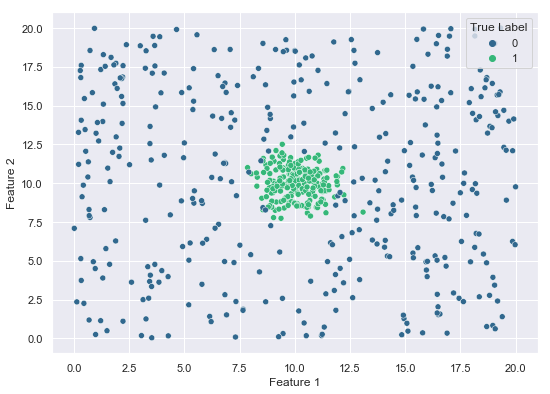

In [ ]:
simulated_data = Simulated_Data(size = 20)
simulated_data.initialize(n_field = 400)
simulated_data.visualize()

In [ ]:
simulated_data.data.head()

,star,feature_1,feature_2,true_label
0,1,10.026224,10.418249,1
1,2,9.378248,11.234571,1
2,3,10.132923,9.877623,1
3,4,10.412867,10.093132,1
4,5,11.832466,8.760883,1


### Running GMM model on the simulated data

In [ ]:
class Run_GMM_Model():
    '''
    This class runs GMM model to the selected part of the datset, predicts the member and field star
    group, calculates the evaluation metric and visualizes the results
    
    Attribute:
    ----------
    data:           Full dataset of (simulated) stars
    working_data:   Filtered dataset by a given half-width value. 
                    We will run GMM model in this filtered dataset
                    
    (The following three attributes are used to determine the working_data)
    center_x:       x coordinate of member group's center (at the center of grid)
    center_y:       y coordinate of member group's center (at the center of grid)
    std_member:     Standard deviation of the member group normal distribution
    
    feature_colums: The list of columns used as the features of GMM model
    gmm:            The GMM model applied on working data
    member:         The predicted member stars by GMM model in working data
    non_member:     The predicted field stars by GMM model in working data
    mss_metric:     Modified Silhouttee Score (MSS) for the current member and non_member group
    '''
    def __init__(self, simulated_data):
        '''
        Initializes the class with a dataset.
        
        Input: 
        -------
        simulated_data: An instance of a Simulated_Data class 
        '''
        self.data = simulated_data.data
        self.std_member = simulated_data.std_member
        self.center_x = simulated_data.center_x
        self.center_y = simulated_data.center_y
        
    def get_working_data(self, filter_factor):
        '''
        Returns the filtered subset of the datset based on the given half-width
        
        Input:
        ------
        filter_factor: The multiplication factor of the member standard deviation to defined the half-width
                       If filter_factor is k, the half-width will be k times member_SD
        '''
        k = filter_factor
        
        # choosing only the stars which lies in the following range: center +- k*member_SD (half-width)
        filter = (abs(self.data.feature_1 - self.center_x) < k*self.std_member) \
                 & (abs(self.data.feature_2 - self.center_y) < k*self.std_member)
        working_data = self.data.loc[filter, :]
        return working_data
    
    def get_member(self, filter_factor, feature_columns, cutoff = 0.6, random_state = None):
        '''
        Classifies the working data into member and non_member groups.
        
        Inputs:
        -------
        filter_factor:  If filter_factor is k, the half-width will be k times member_SD
        feature_colums: The list of columns used as the features of GMM model
        cutoff:         Threshold used for member cutoff. Default is 0.6.
                        If cutoff is 0.6, stars with membership probability >= 0.6 are members
                        and the stars with membership probability <= 0.4 (1-0.6) are non-members
        random_state:   Random State of the GMM algorithm. Used for reproducibility.
                        If 'None', then each time a new random seed will be used. Default is None.
                        
        GMM clusters the data into two groups. The group which has smaller average standard deviation 
        (thus more compact) is defined as the member group.
        '''
        self.feature_columns = feature_columns
        self.working_data = self.get_working_data(filter_factor)
        
        features = self.working_data.loc[:,feature_columns].dropna()
        
        # if there is less than 2 stars, GMM cannot divide them in two groups
        if len(self.working_data) < 2:
            raise ValueError('Less than two stars in the data')

        # normalizing the features
        scaled_features = pd.DataFrame({})
        for column in features.columns:
            scaled_features[column] = (features[column] - np.median(features[column]))/np.std(features[column])

        # Running GMM model: n_init = Number of Different Initialization tried by GMM
        gmm = GaussianMixture(n_components=2, n_init = 5, random_state = random_state)
        gmm.fit(scaled_features)

        #predictions from gmm
        labels = gmm.predict(scaled_features)      # group no (0 or 1)
        probs = gmm.predict_proba(scaled_features) # membership probability

        # first assuming the group 1 is the member group
        self.working_data.loc[:, 'PMemb'] = probs[:, 1] # membership probability to be in group 1
        self.working_data.loc[:, 'gmm_label'] = labels

        # select member and non-member based on member threshold
        non_member_ind = self.working_data.loc[:, 'PMemb'] <= (1-cutoff)
        non_member = self.working_data.loc[non_member_ind, :]

        member_ind = self.working_data.loc[:, 'PMemb'] >= cutoff
        member = self.working_data.loc[member_ind, :]

        # check if the average standard deviation of member group is larger.
        # if yes, then change the member group and assign group 0 as the member group. 
        if member[feature_columns].std().mean() > non_member[feature_columns].std().mean():
            self.working_data.loc[:, 'PMemb'] = probs[:, 0]  # membership probability to be in group 1
            self.working_data.loc[:, 'gmm_label'] = 1-labels 

            # select member and non-member based on member threshold using new PMemb value
            non_member_ind = self.working_data.loc[:, 'PMemb'] <= (1-cutoff)
            non_member = self.working_data.loc[non_member_ind, :]

            member_ind = self.working_data.loc[:, 'PMemb'] >= cutoff
            member = self.working_data.loc[member_ind, :]

        # save the results as an attribute of the class
        self.member, self.non_member, self.gmm = member, non_member, gmm
    
    def get_MSS_metric(self, epsilon = 1e-7):
        '''
        Calculates modified silhouttee score (MSS) from the current member and non_member group.
        If any of the group has less than 2 member (thus SD = 0 or None), MSS value is 0.
        Otherwise, MSS is the average of (field_SD - member SD)/max(field_SD, member SD, epsilon) for all features.
        
        epsilon: a very small number to avoid dividing by 0, when both SD are 0. Default value 1e-7.
        '''
        
        if len(self.member) < 2 or len(self.non_member) < 2:
            return 0

        metric = np.zeros(len(self.feature_columns))
        for i in range(len(self.feature_columns)):
            feature_i = self.feature_columns[i]
            # (field_SD - member SD)/max(field_SD, member SD, epsilon) for each features
            metric[i] = (np.std(self.non_member[feature_i]) - np.std(self.member[feature_i])) \
                    / max(np.std(self.member[feature_i]), np.std(self.non_member[feature_i]), epsilon)
        
        self.mss_metric = metric.mean() # taking average over for all features
        return self.mss_metric
    
    def visualize_member(self, title = None):
        '''
        Visualizes the following three plots in a 1x3 (row x col) setup:
        1. current working data colored by their GMM assigned label
        2. current member and non_member data given the cutoff.
        3. current working data colored by their true label (given in simulated data) 
        
        Input:
        -------
        title: An overall title of these set of figures
        '''
        plt.figure(figsize=(22,6))

        if title:
            plt.suptitle(title)

        plt.subplot(131)
        sns.scatterplot(data = self.working_data, x='feature_1', y='feature_2', hue = 'gmm_label',
                        palette = 'viridis')
        plt.xlabel('Feature 1')
        plt.ylabel('Feature 2')
        plt.legend(title = 'GMM Assigned Label')

        plt.subplot(132)
        sns.scatterplot(data = self.member, x='feature_1', y='feature_2', label = 'member', color='green')
        sns.scatterplot(data = self.non_member, x='feature_1', y='feature_2', label = 'non_member', color='blue')
        plt.xlabel('Feature 1')
        plt.ylabel('Feature 2')

        plt.subplot(133)
        sns.scatterplot(data = self.working_data, x='feature_1', y='feature_2', hue = 'true_label',
                        palette = 'viridis')
        plt.xlabel('Feature 1')
        plt.ylabel('Feature 2')
        plt.legend(title = 'True Label')
        plt.show()

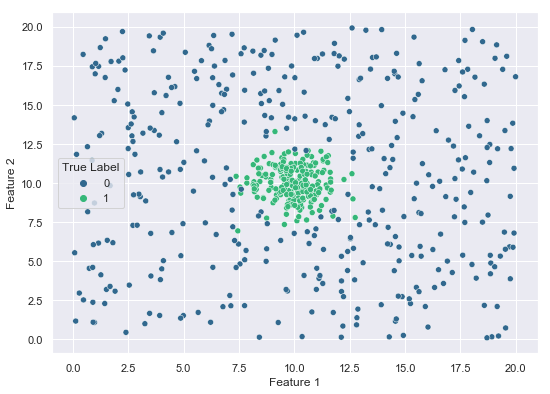

In [ ]:
# creating a simulated data with 20 gridsize and 400 field star
simulated_data = Simulated_Data(size = 20)
simulated_data.initialize(n_field = 400)
simulated_data.visualize()

In [ ]:
import warnings
warnings.filterwarnings('ignore')

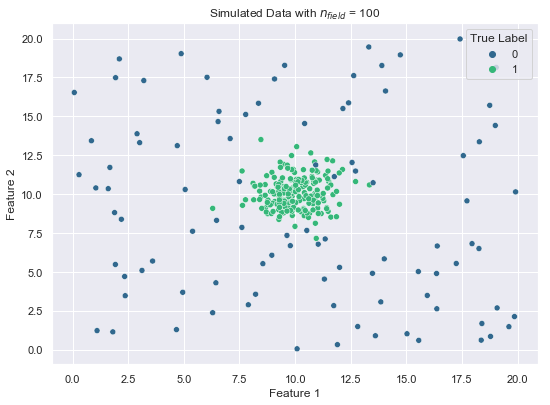

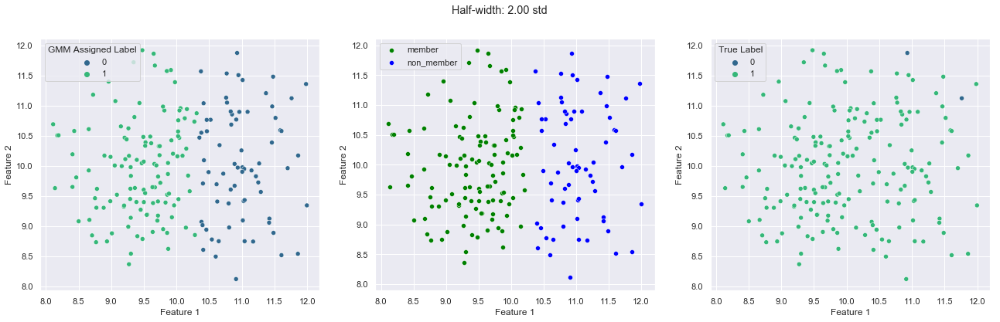

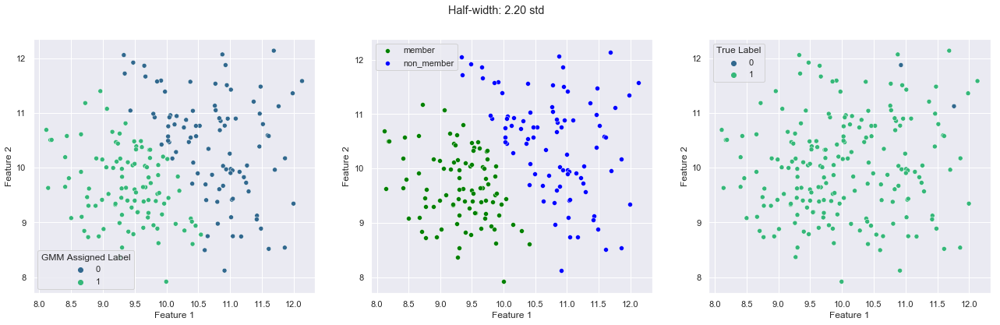

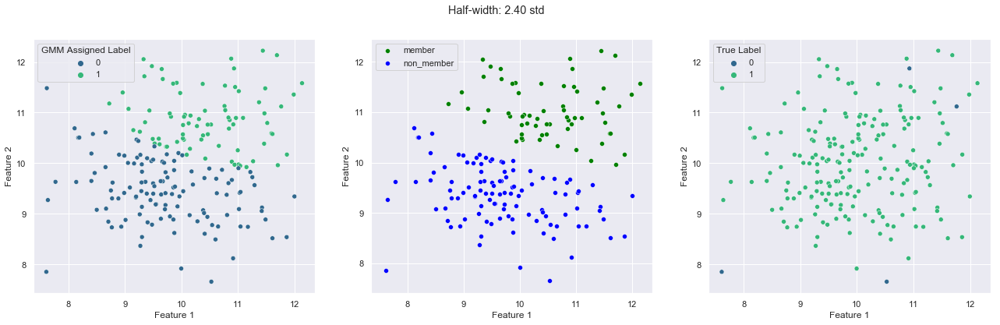

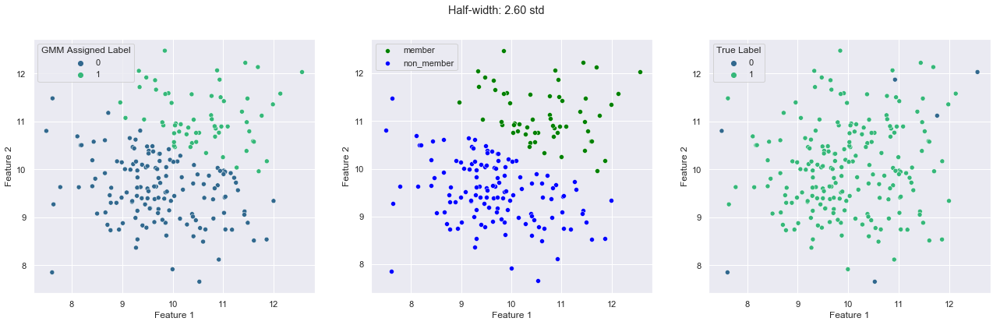

...

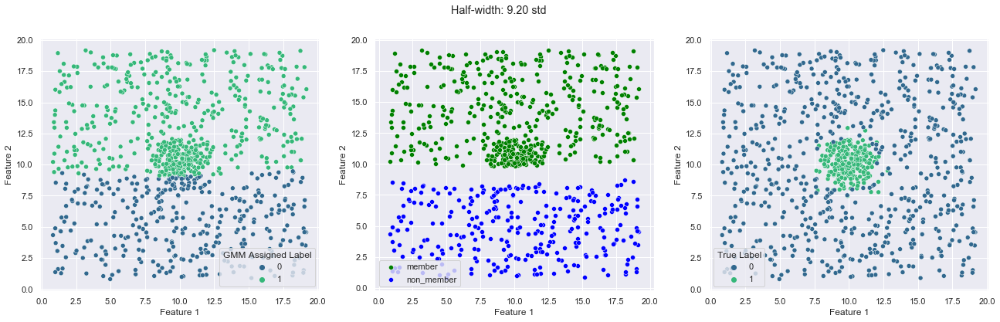

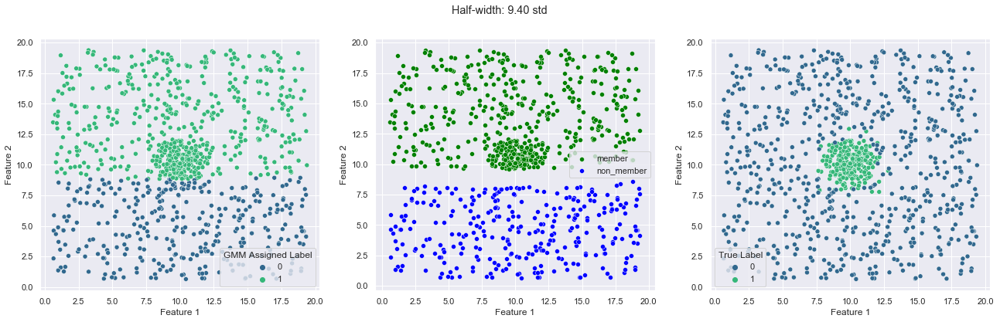

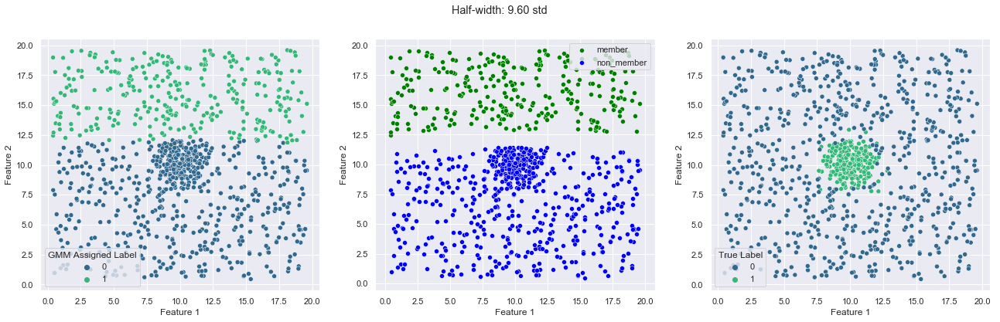

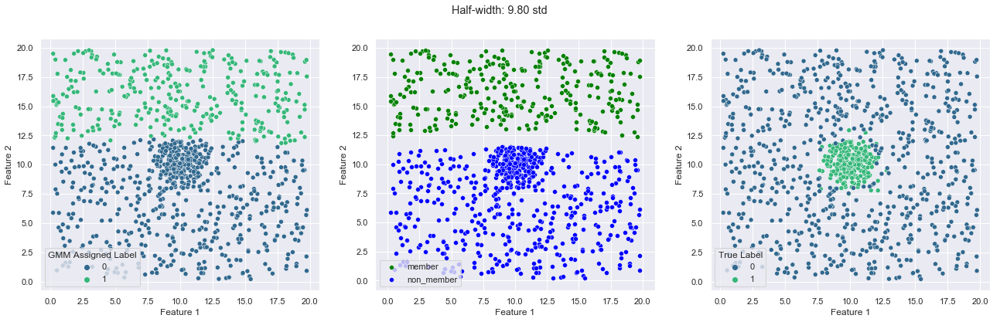

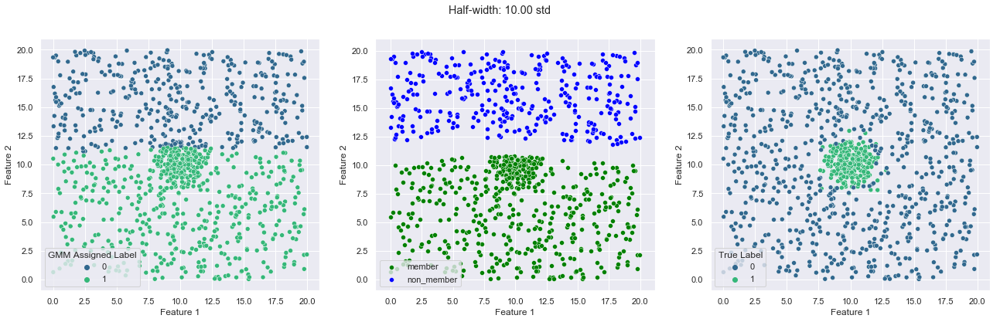

In [ ]:
n_member = 200 # we will keep the member size constant 
size = 20

# creating a simulated data with 20 gridsize 
simulated_data = Simulated_Data(size = size)

# different values to try in each iteration for n_trial number of  time
# we will take the average MSS over all the trials for a given set of half-width and n_field
n_trial = 20
filter_factor = np.linspace(2, 10, 41) # half-width = filter_factor * SD
n_fields = np.array([100, 200, 300, 400, 600, 800])

len_fields = len(n_fields)
len_filter = len(filter_factor)

metric = np.full((len_fields,len_filter), -1, dtype=float)

for i in range(len_fields):
    n_field = n_fields[i]

    # (re)initialize the simulated data with differnt number of field star
    simulated_data.initialize(n_field = n_field, n_member = n_member)
    simulated_data.visualize(title = 'Simulated Data with $n_{field}$ = '+ str(n_field))
    
    gmm_model = Run_GMM_Model(simulated_data)

    for j in range(len_filter):
        metric_value = 0
        
        for _ in range(n_trial): 
            k = filter_factor[j]
            
            feature_columns = ['feature_1', 'feature_2']
            # get member and non_member
            # we want randomness in every trial, thus we kept random_state = None
            gmm_model.get_member(filter_factor = k, feature_columns = feature_columns)

            # metric calculation
            metric_value += gmm_model.get_MSS_metric()
        
        metric[i,j] = (metric_value/n_trial) # taking average mss over all the trials
        gmm_model.visualize_member(title = f'Half-width: {filter_factor[j]:0.2f} std')

In [ ]:
plt.figure(figsize=(8,7))

for i in range(len(metric)):
    sns.lineplot(x=filter_factor, y=metric[i], label = n_fields[i])
    plt.xlabel('Half-width (std)')
    plt.ylabel('Modified Silhouette Score')
    plt.legend(title = 'n_field')
plt.show()

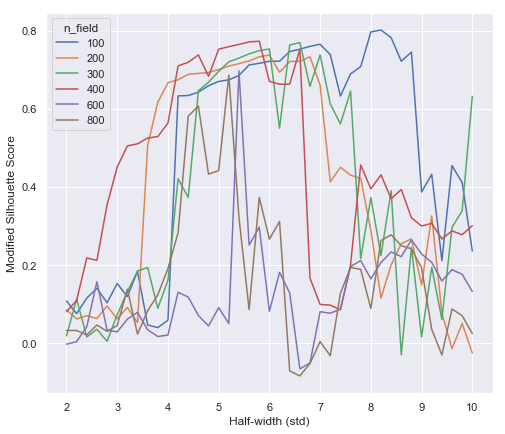

In [ ]:
plt.figure(figsize=(8,7))

for i in range(len(metric)):
    sns.lineplot(x=filter_factor, y=metric[i], label = n_fields[i])
    plt.xlabel('Half-width (std)')
    plt.ylabel('Modified Silhouette Score')
    plt.legend(title = 'n_field')
plt.show()

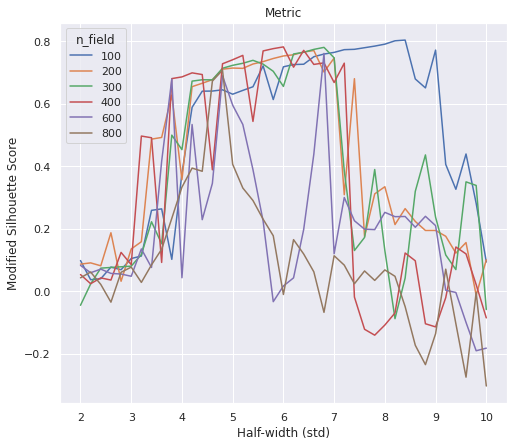

In [ ]:
plt.figure(figsize=(8,7))

for i in range(len(metric)):
    sns.lineplot(x=filter_factor, y=metric[i], label = n_fields[i])
    plt.xlabel('Half-width (std)')
    plt.ylabel('Modified Silhouette Score')
    plt.legend(title = 'n_field')
plt.show()

### Appendix:

#### Metric Testing

Here I run GMM with different dataset to get member and non-member group and plot them with the calculated MSS value. This will be useful to see how the member-field distribution looks like for different value of MSS.

After getting a number of member and non-member group, I sort them in increasing order of MSS metric and plot them. Additionally, I also made a gif showing how for a higher value of the MSS metric, the distribution of member becomes more compact and field stars become more uniformly distributed.

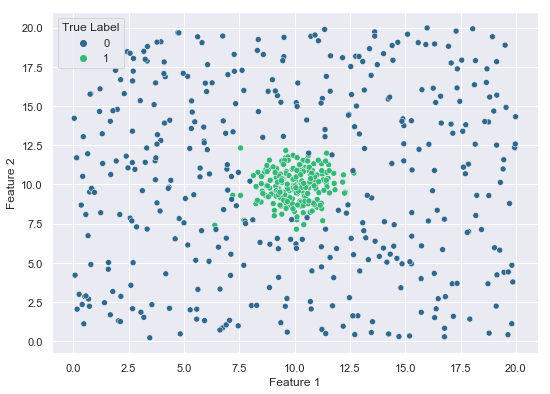

In [ ]:
# Initialize the simulation with gridsize of 20 and 400 field star,
simulated_data = Simulated_Data(size = 20)
simulated_data.initialize(n_field = 400)
simulated_data.visualize()

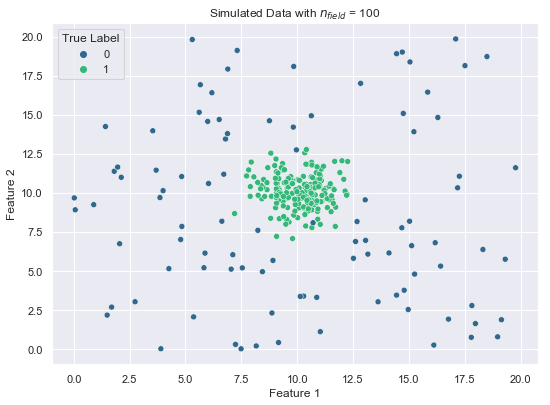

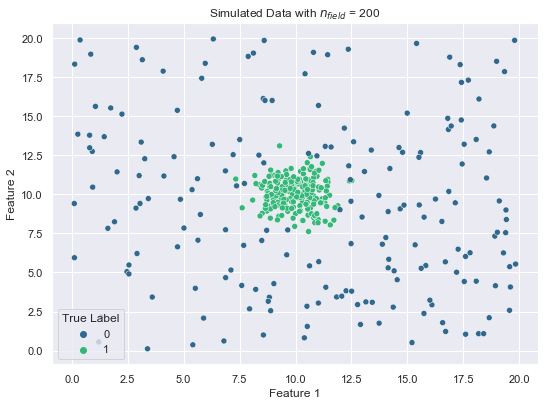

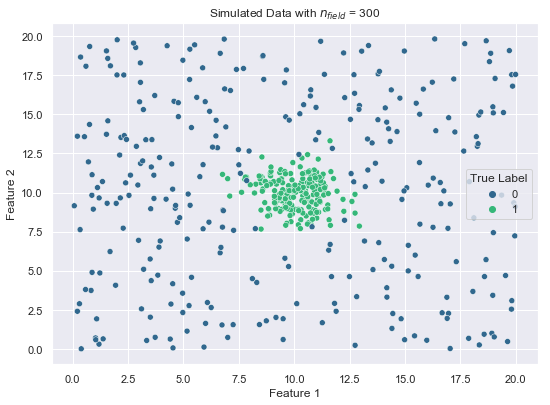

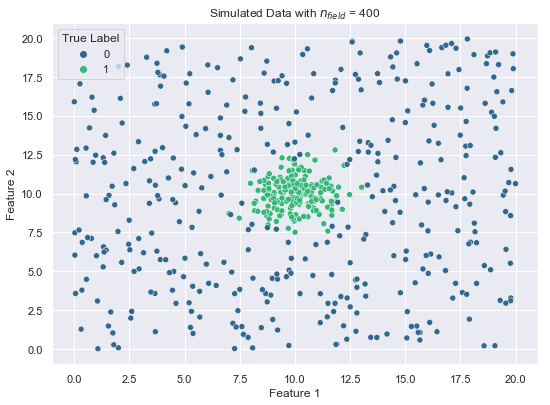

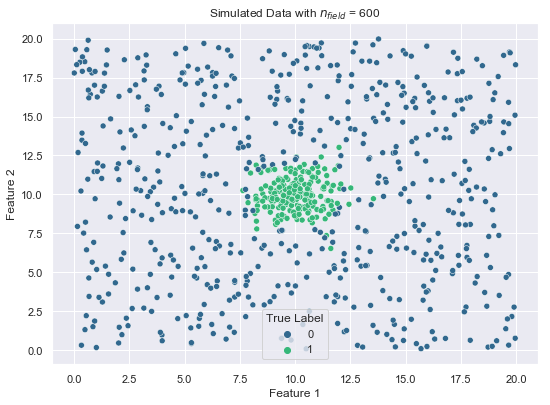

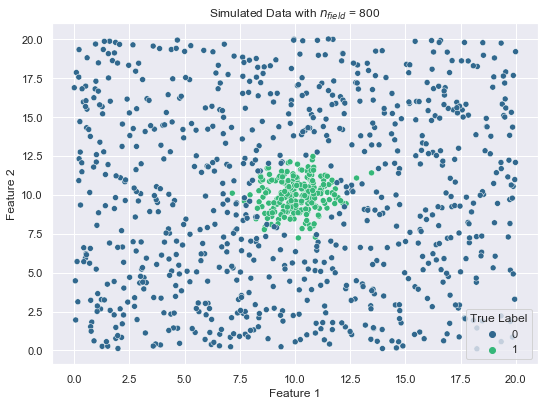

In [ ]:
n_member = 200
size = 20
simulated_data = Simulated_Data(size = size)

# different values to try in each iteration for n_trial number of time
n_fields = np.array([100, 200, 300, 400, 600, 800])
filter_factor = np.linspace(2, 10, 5)       # half-width = filter_factor * SD
n_trial = 5

len_fields = len(n_fields)
len_filter = len(filter_factor)

metric_info = []

for i in range(len_fields):
    n_field = n_fields[i]
    
    # (re)initialize the simulated data with differnt number of field star
    simulated_data.initialize(n_field = n_field, n_member = n_member)
    simulated_data.visualize(title = 'Simulated Data with $n_{field}$ = '+ str(n_field))
    gmm_model = Run_GMM_Model(simulated_data)

    for j in range(len_filter):
        
        for _ in range(n_trial):
            k = filter_factor[j]

            feature_columns = ['feature_1', 'feature_2']
            # get member and non_member
            # we want randomness in every trial, thus we kept random_state = None
            gmm_model.get_member(filter_factor = k, feature_columns = feature_columns)

            # metric calculation
            metric = gmm_model.get_MSS_metric()

            # saving the (members, non_member and mss) as a list of tuples
            metric_info.append((gmm_model.member, gmm_model.non_member, metric))

In [ ]:
# sort the metric info based on absolute mss value (2nd index of the tuple)
metric_info.sort(key=lambda tup: abs(tup[2]))

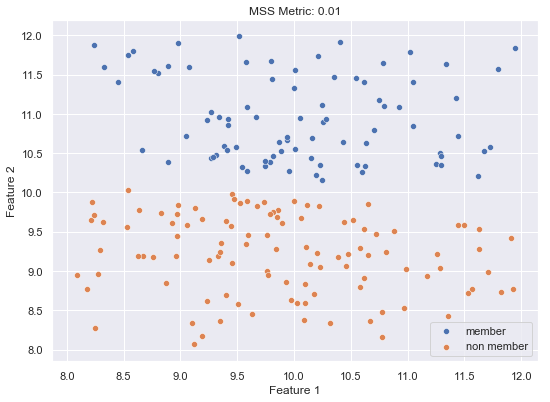

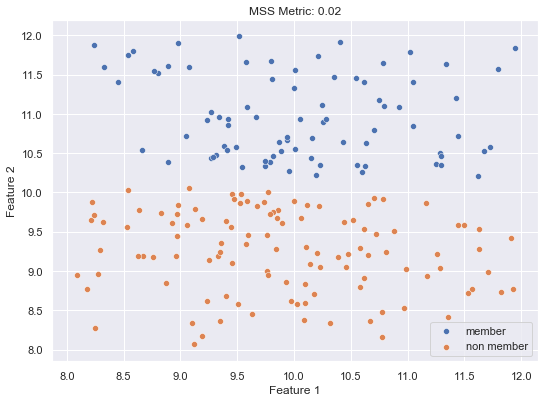

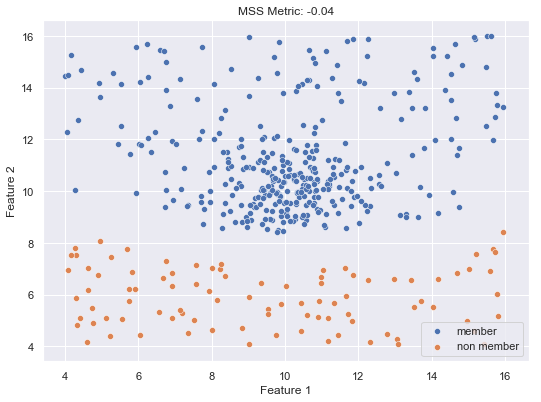

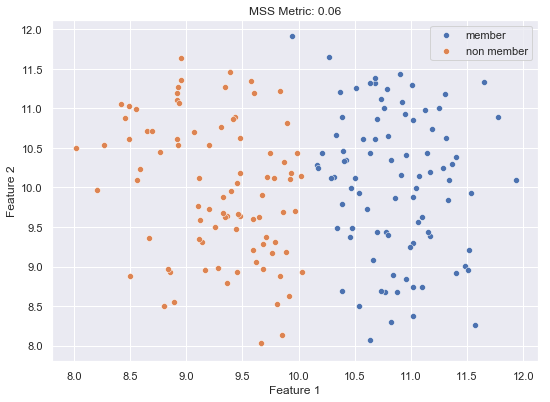

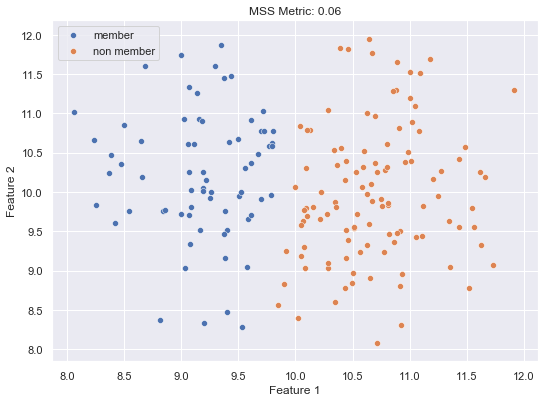

...

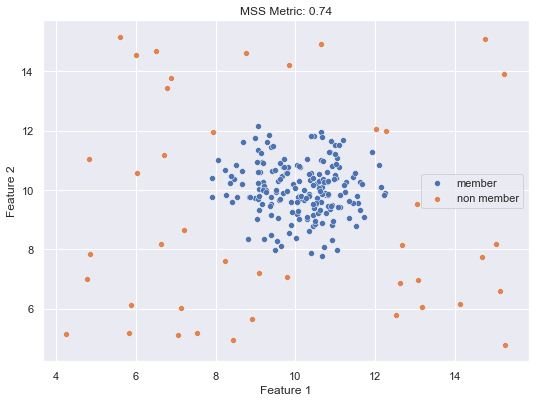

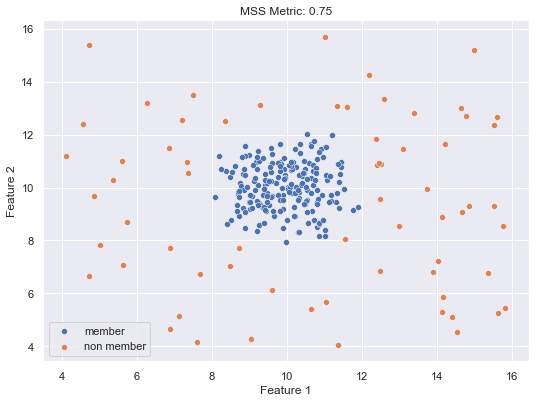

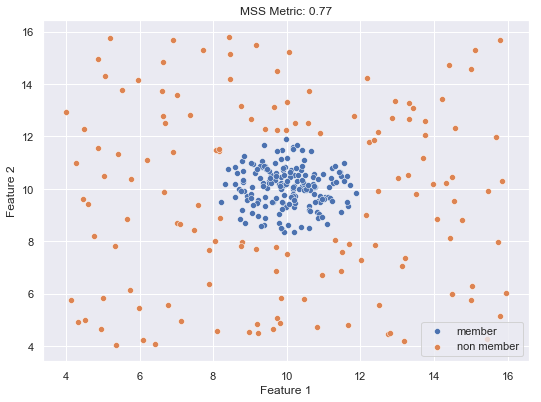

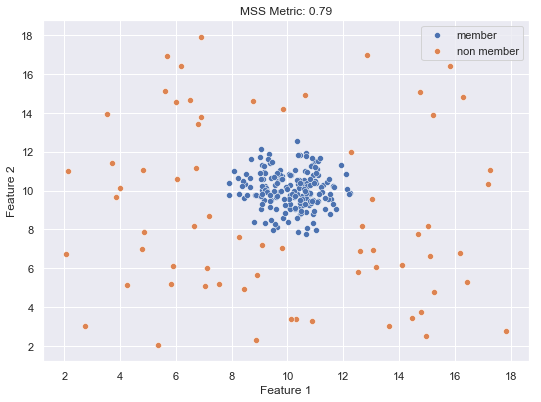

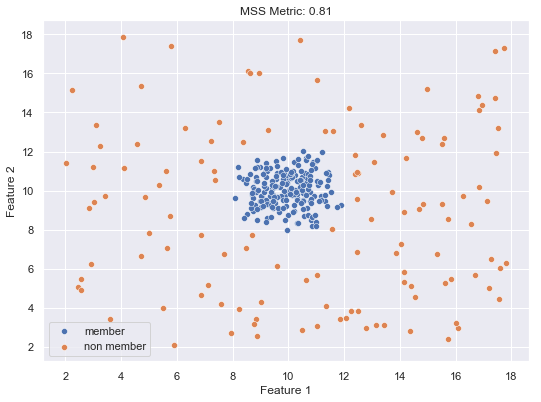

In [ ]:
# plot every 5 metric data from the sorted metric info 
for i in range(0, len(metric_info), 5):
    member, non_member, mss = metric_info[i]
    sns.scatterplot(data = member, x='feature_1', y='feature_2', label = 'member', palette = 'viridis')
    sns.scatterplot(data = non_member, x='feature_1', y='feature_2', label = 'non member', palette = 'viridis')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.title(f'MSS Metric: {mss:0.2f}')
    plt.show()

#### Animation

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

<IPython.core.display.Javascript object>


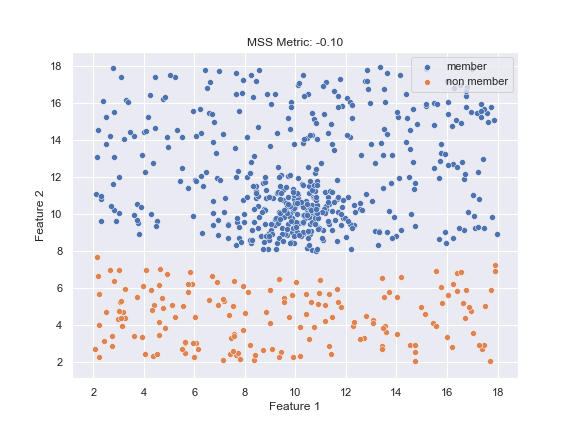

In [ ]:
#############
# ANIMATION #
#############

%matplotlib notebook

# initialize the figure
fig, ax = plt.subplots(figsize=(8,6))

def animate(i):
    # clear the axis each frame
    ax.clear()
    
    member, non_member, mss = metric_info[i]
    # replot the scatterplot
    sns.scatterplot(data = member, x='feature_1', y='feature_2', label = 'member', palette = 'viridis', ax=ax)
    sns.scatterplot(data = non_member, x='feature_1', y='feature_2', label = 'non member', palette = 'viridis',ax=ax)

    # reformat the labels
    ax.set_xlabel('Feature 1')
    ax.set_ylabel('Feature 2')
    ax.set_title(f'MSS Metric: {mss:0.2f}')
    ax.legend(loc='upper right')

    
# starts animation
ani = animation.FuncAnimation(fig, animate, frames=len(metric_info), interval=500)
plt.show(ani)   # comment this if you run in google colab

# Uncomment this if you run in google colab
# from IPython.display import HTML
# HTML(ani.to_html5_video())

In [ ]:
ani.save('member_nonmember_plot_for_increasing_MSS.gif', writer='pillow')
